#**FOREST** **FIRE** **DETECTION** **SYSTEM**

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import Callback

**IMPORTING THE DATASET**

In [ ]:
#connect to google drive
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
#define path
dataset=tf.keras.preprocessing.image_dataset_from_directory(
    "/content/gdrive/MyDrive/ForestFireDataset")

Found 2948 files belonging to 1 classes.


In [ ]:
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

print(tf.__version__)

2.14.0


**PREPROCESSING**

***i) splitting the dataset into training and testing***

In [ ]:
datagen = tf.keras.preprocessing.image.ImageDataGenerator(validation_split=0.3)

DATA_PATH = "/content/gdrive/MyDrive/ForestFireDataset"

train_data = datagen.flow_from_directory(
                '/content/gdrive/MyDrive/ForestFireDataset/train',
                target_size=(200, 200),
                class_mode="binary",
                batch_size=32,
                shuffle=True,
                subset='training',
                seed=42)
test_data = datagen.flow_from_directory(
                '/content/gdrive/MyDrive/ForestFireDataset/train',
                target_size=(200, 200),
                class_mode="binary",
                shuffle=False,
                batch_size=32,
                subset='validation',
                seed=42)

# Extract features and labels from the generator
X_train, y_train = train_data.next()


# Extract features and labels from the test data generator
X_test, y_test = test_data.next()


Found 2212 images belonging to 2 classes.
Found 736 images belonging to 2 classes.


In [ ]:
print(test_data.class_indices)

{'fire': 0, 'nofire': 1}


***ii) visualizing the data***

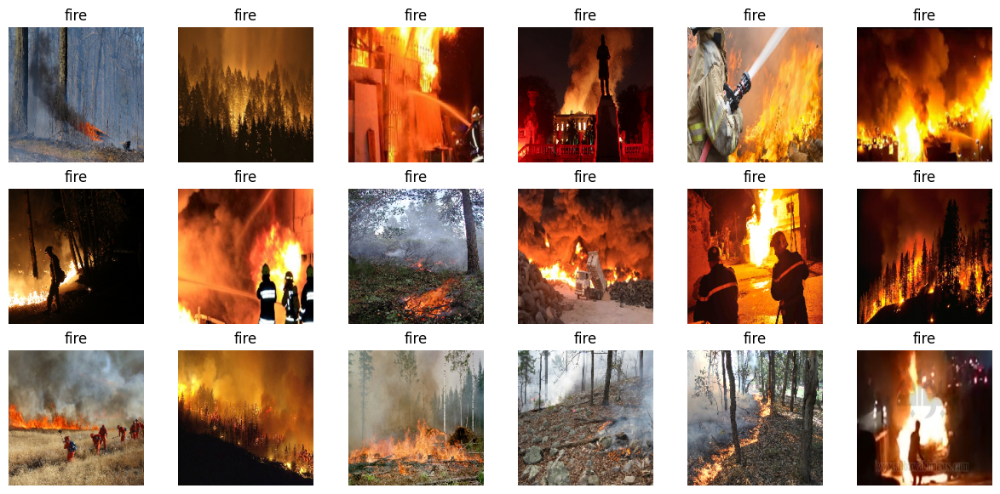

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 7))
images, labels = next(test_data)
i = 0
class_names = ['fire', 'nofire']

for image, label in zip(images, labels):
    ax = plt.subplot(3, 6, i + 1)
    plt.imshow(image.astype("uint8"))
    plt.title(class_names[int(label)])
    plt.axis("off")
    i += 1
    if i == 18:
        break

plt.show()


***iii) augmenting the data***

In [ ]:
# Reshape the data to rank-4 tensor
X_train = X_train.reshape(-1, 300, 400, 1)
X_test = X_test.reshape(-1, 300, 400, 1)

# Ensure labels have the correct shape (binary classification)
y_train = y_train.reshape(-1, 1)
y_test = y_test.reshape(-1, 1)

In [ ]:
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)

y_train shape: (32, 1)
y_test shape: (32, 1)


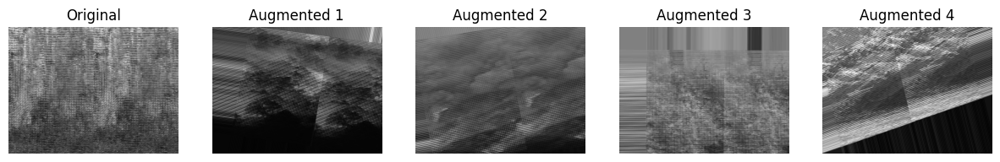

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt

# Create an instance of the ImageDataGenerator with desired augmentation settings
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Fit the ImageDataGenerator on your training data
datagen.fit(X_train)

num_images_to_visualize = 4
augmented_images, augmented_labels = next(datagen.flow(X_train, y_train, batch_size=num_images_to_visualize))

# Display the original and augmented images
fig, axes = plt.subplots(1, num_images_to_visualize + 1, figsize=(15, 3))

# Display original image
axes[0].imshow(X_train[0].reshape(300, 400), cmap='gray')  # Assuming grayscale images
axes[0].set_title('Original')
axes[0].axis('off')

# Display augmented images
for i in range(num_images_to_visualize):
    axes[i + 1].imshow(augmented_images[i].reshape(300, 400), cmap='gray')  # Assuming grayscale images
    axes[i + 1].set_title(f'Augmented {i+1}')
    axes[i + 1].axis('off')

plt.show()


**BUILDING THE MODELS**

 **1. CNN MODEL**

***model framework***

In [ ]:
from tensorflow.keras.layers import Input, GlobalAveragePooling2D, Dense, Dropout, Activation
from tensorflow.keras import regularizers

base_model = tf.keras.applications.EfficientNetB0(include_top=False)
base_model.trainable = False

inputs = Input(shape=(96, 96, 3), name="input_layer")
x = base_model(inputs)

x = GlobalAveragePooling2D(name="GlobalAveragePooling2D")(x)
#x = Dropout(0.5)(x)

# Apply Dense layer with L2 regularization
x = Dense(128, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)

# Apply Dropout for regularization
x = Dropout(0.5)(x)

x = Dense(1, name='output_layer')(x)

outputs = Activation('sigmoid', name='sigmoid_activation')(x)

model = tf.keras.Model(inputs, outputs)
optimizer=tf.keras.optimizers.Adam(learning_rate=0.001)
model.compile(loss="binary_crossentropy",
              optimizer=tf.keras.optimizers.Adam(),
              metrics = ['accuracy'])

model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetb0 (Functional  (None, None, None, 1280   4049571   
 )                           )                                   
                                                                 
 GlobalAveragePooling2D (Gl  (None, 1280)              0         
 obalAveragePooling2D)                                           
                                                                 
 dense_1 (Dense)             (None, 128)               163968    
                                                                 
 dropout_1 (Dropout)         (None, 128)               0         
                                                                 
 output_layer (Dense)        (None, 1)                 129 

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

***training and testing***

In [37]:
history = model.fit(train_data,
                    epochs=5,
                    steps_per_epoch=len(train_data),
                    validation_data=test_data,
                    validation_steps=len(test_data),callbacks=[early_stopping])

Epoch 1/5
66/66 [==============================] - 220s 3s/step - loss: 1.2228 - accuracy: 0.9666 - val_loss: 0.6855 - val_accuracy: 0.8761
Epoch 2/5
66/66 [==============================] - 232s 4s/step - loss: 0.2875 - accuracy: 0.9890 - val_loss: 0.3137 - val_accuracy: 0.9230
Epoch 3/5
66/66 [==============================] - 233s 4s/step - loss: 0.1386 - accuracy: 0.9914 - val_loss: 0.1730 - val_accuracy: 0.9621
Epoch 4/5
66/66 [==============================] - 214s 3s/step - loss: 0.1017 - accuracy: 0.9890 - val_loss: 0.1900 - val_accuracy: 0.9498
Epoch 5/5
66/66 [==============================] - 228s 3s/step - loss: 0.0997 - accuracy: 0.9885 - val_loss: 0.1598 - val_accuracy: 0.9587


In [ ]:
results = model.evaluate(test_data)

28/28 [==============================] - 66s 2s/step - loss: 0.2470 - accuracy: 0.9241


In [ ]:
model.save("exported_model.hdf5")

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


***performance prediction***

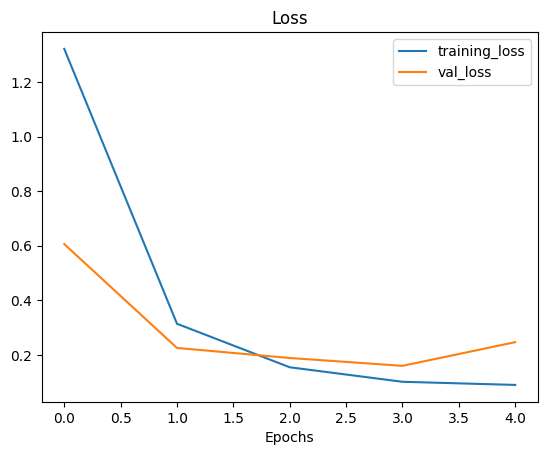

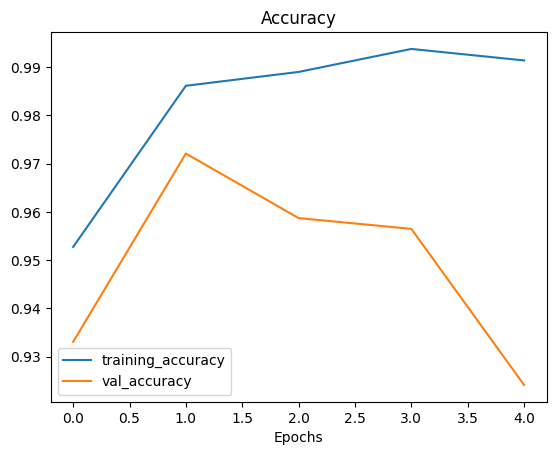

In [ ]:
loss = history.history['loss']
val_loss = history.history['val_loss']

accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

epochs = range(len(history.history['loss']))

# Plot loss
plt.plot(epochs, loss, label='training_loss')
plt.plot(epochs, val_loss, label='val_loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.legend()

# Plot accuracy
plt.figure()
plt.plot(epochs, accuracy, label='training_accuracy')
plt.plot(epochs, val_accuracy, label='val_accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.legend();

***result***

In [ ]:
y_pred = model.predict(test_data)
y_pred = np.squeeze(np.round(y_pred), axis=1)

y_true = test_data.classes

len(y_pred), len(y_true)

28/28 [==============================] - 61s 2s/step


(896, 896)



*   Classification Report




In [ ]:
from sklearn.metrics import classification_report

report = classification_report(y_true, y_pred)
print(report)

              precision    recall  f1-score   support

           0       0.58      0.66      0.62       506
           1       0.47      0.39      0.43       390

    accuracy                           0.54       896
   macro avg       0.53      0.53      0.52       896
weighted avg       0.53      0.54      0.54       896





*   Confusion Matrix



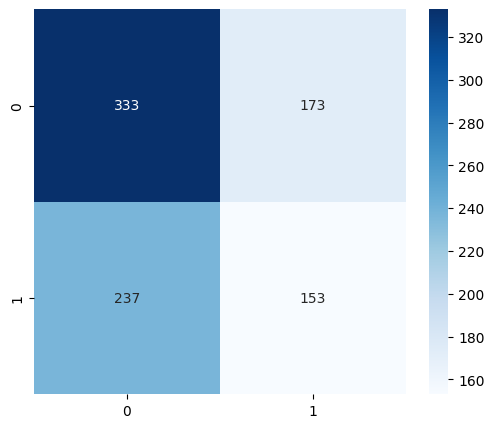

In [ ]:
cm = tf.math.confusion_matrix(y_true, y_pred)

import seaborn as sn
plt.figure(figsize = (6, 5));
sn.heatmap(cm, annot=True,
           fmt='',
           cmap='Blues');



*   ROC-AUC curve score




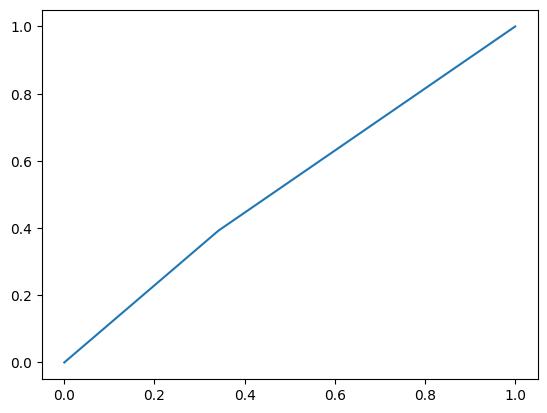

AUC-ROC: 0.5252052295530556


In [ ]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

fpr, tpr, thresholds = roc_curve(y_true, y_pred)
import matplotlib.pyplot as plt
plt.plot(fpr,tpr)
plt.show();

auc_roc = roc_auc_score(y_true, y_pred)
print(f"AUC-ROC: {auc_roc}")

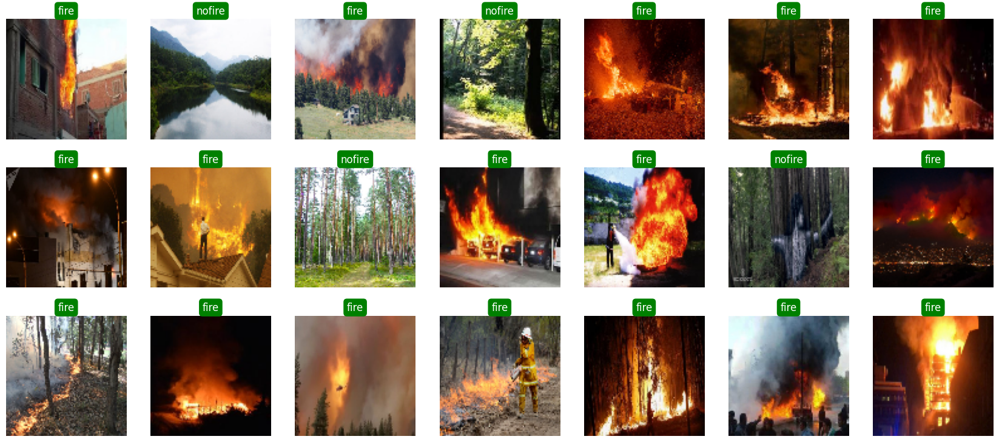

In [ ]:
import matplotlib.pyplot as plt
import tensorflow as tf

plt.figure(figsize=(21, 9))

shuffle_test_data = test_data
shuffle_test_data.shuffle = True
images, labels = next(shuffle_test_data)

i = 0

for image, label in zip(images, labels):
    ax = plt.subplot(3, 7, i + 1)

    # Resize the image to match the expected input shape of the model (224, 224, 3)
    resized_image = tf.image.resize(image, (224, 224))

    plt.imshow(resized_image.numpy().astype("uint8"))

    # Get the true label
    x = label

    # Get the model's predicted probability and round it to get the predicted label
    pred_prob = model.predict(tf.expand_dims(resized_image, axis=0), verbose=0)
    pred = class_names[int(np.round(pred_prob)[0])]

    # Set title with color-coded background based on prediction correctness
    if pred == class_names[int(x)]:
        plt.title(f"{pred}", color='white', bbox=dict(boxstyle="round", color='green'))
    else:
        plt.title(f"{pred}", color='white', bbox=dict(boxstyle="round", color='red'))

    plt.axis("off")
    i += 1
    if i == 21:
        break

plt.show()


**2. RANDOM FORESTS**


In [ ]:
!pip install rasterio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 53.4 MB/s eta 0:00:00


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import rasterio as rio

from sklearn.metrics import classification_report
from sklearn.ensemble import RandomForestClassifier

***model framework***

In [ ]:
# Reshape features (images) to 1D arrays
X_train = X_train.reshape((X_train.shape[0], -1))


# Reshape features (images) to 1D arrays
X_test = X_test.reshape((X_test.shape[0], -1))


# Display the shape of X_train
print("Shape of X_train:", X_train.shape)

# Display the shape of X_test
print("Shape of X_test:", X_test.shape)


Shape of X_train: (32, 120000)
Shape of X_test: (32, 120000)


In [ ]:
rfc = RandomForestClassifier(n_estimators=100, random_state=42, verbose=3, n_jobs=-1)

***training***

In [ ]:
rfc.fit(X_train, y_train)

<ipython-input-72-823e2bba21ee>:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rfc.fit(X_train, y_train)
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  28 tasks      | elapsed:    0.1s


building tree 1 of 100
building tree 2 of 100
building tree 3 of 100
building tree 4 of 100
building tree 5 of 100
building tree 6 of 100
building tree 7 of 100
building tree 8 of 100
building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100
building tree 13 of 100
building tree 14 of 100
building tree 15 of 100
building tree 16 of 100
building tree 17 of 100
building tree 18 of 100
building tree 19 of 100
building tree 20 of 100building tree 21 of 100

building tree 22 of 100
building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100
building tree 29 of 100building tree 30 of 100

building tree 31 of 100
building tree 32 of 100
building tree 33 of 100
building tree 34 of 100
building tree 35 of 100
building tree 36 of 100
building tree 37 of 100
building tree 38 of 100
building tree 39 of 100
building tree 40 of 100
building tree 41 of 100
building tree 42 of 100
b

[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.3s finished


RandomForestClassifier(n_jobs=-1, random_state=42, verbose=3)

***prediction and result***

In [ ]:
from sklearn.metrics import accuracy_score
y_pred = rfc.predict(X_test)

[Parallel(n_jobs=2)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  28 tasks      | elapsed:    0.0s
[Parallel(n_jobs=2)]: Done 100 out of 100 | elapsed:    0.0s finished


In [ ]:
# Evaluate the accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

Accuracy: 0.8125




*   Classification Report



In [ ]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

         0.0       1.00      0.81      0.90        32
         1.0       0.00      0.00      0.00         0

    accuracy                           0.81        32
   macro avg       0.50      0.41      0.45        32
weighted avg       1.00      0.81      0.90        32



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))




*   ROC- AUC curve score



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_ranking.py:1029: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


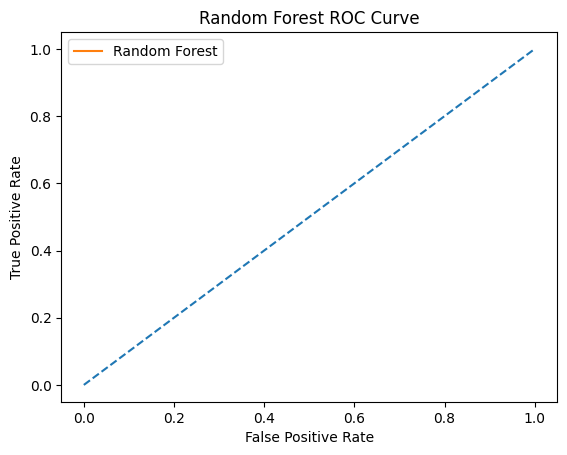

In [ ]:
from sklearn.metrics import roc_curve
import matplotlib.pyplot as plt

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred)

# Plotting the ROC curve
plt.plot([0, 1], [0, 1], '--')  # Diagonal line representing random guessing
plt.plot(fpr, tpr, label='Random Forest')  # ROC curve for Random Forest
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title('Random Forest ROC Curve')
plt.legend()
plt.show()

 **3.Logistic regression model**

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import os
import cv2
from google.colab.patches import cv2_imshow




In [ ]:
size = 200

In [ ]:
import os
import cv2
import numpy as np

def flatten_images(folder_path, size):
    X = []

    for image_file in os.listdir(folder_path):
        image_path = os.path.join(folder_path, image_file)

        # Make sure to check if the file is an image
        if image_file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
            img = cv2.imread(image_path)

            # Check if the image is not empty
            if img is not None:
                img_converted_size = cv2.resize(img, (size, size))
                X.append(img_converted_size.flatten())
            else:
                print(f"Failed to read image: {image_path}")
        else:
            print(f"Unsupported image format: {image_path}")

    X = np.array(X)

    return X

# Example usage:
folder_path = "/content/gdrive/MyDrive/ForestFireDataset/train/fire"
size = 200  # Set your desired size
flattened_images = flatten_images(folder_path, size)

# Now, flattened_images contains the flattened image data.


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
from sklearn.linear_model import LogisticRegression


lr = LogisticRegression(random_state=42)


lr.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(random_state=42)

In [ ]:
y_pred = lr.predict(X_test)

Accuracy: 0.8529411764705882


<Axes: >

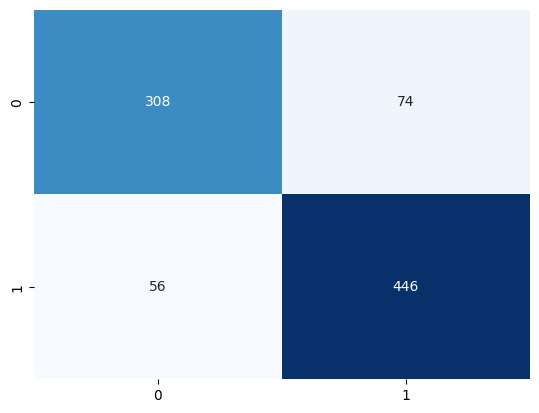

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix


acc = accuracy_score(y_test, y_pred)
con_matrix = confusion_matrix(y_test, y_pred)


print(f"Accuracy: {acc}")



con_matrix



sns.heatmap(con_matrix, annot=True, cmap='Blues', fmt='g', cbar=False)

In [ ]:
import pickle

In [ ]:
forest_fire_model = pickle.load(open("/content/gdrive/MyDrive/ForestFireDetectionModel.pickle", "rb"))

In [ ]:
forest_fire_model

LogisticRegression(random_state=42)

In [ ]:
from sklearn.model_selection import cross_val_predict


lr = LogisticRegression(random_state=42)


y_pred = cross_val_predict(lr, X_train, y_train, cv=5, method='predict_proba')

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

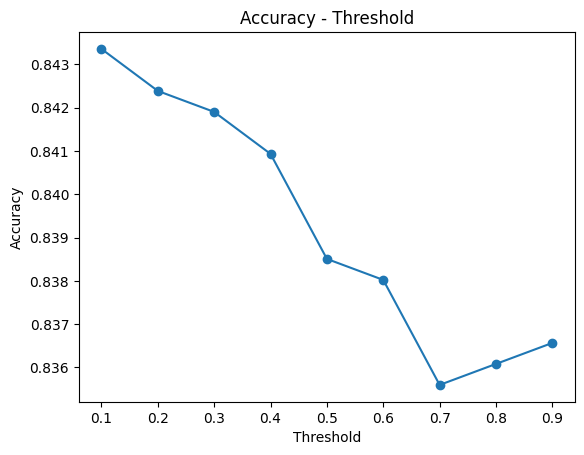

In [ ]:
thresholds = np.arange(0.1, 1.0, 0.1)
accuracy_scores = []
for threshold in thresholds:
    y_train_pred_class = (y_pred[:, 1] > threshold).astype(int)
    accuracy = accuracy_score(y_train, y_train_pred_class)
    accuracy_scores.append(accuracy)


plt.plot(thresholds, accuracy_scores, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Accuracy')
plt.title('Accuracy - Threshold')
plt.show()

In [ ]:
lr = LogisticRegression()
lr.fit(X_train, y_train)
y_pred = (lr.predict_proba(X_test)[:, 1] > 0.8).astype(int)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [ ]:
acc = accuracy_score(y_test, y_pred)
con_matrix = confusion_matrix(y_test, y_pred)


print(f"Accuracy: {acc}")


Accuracy: 0.8518099547511312


<Axes: >

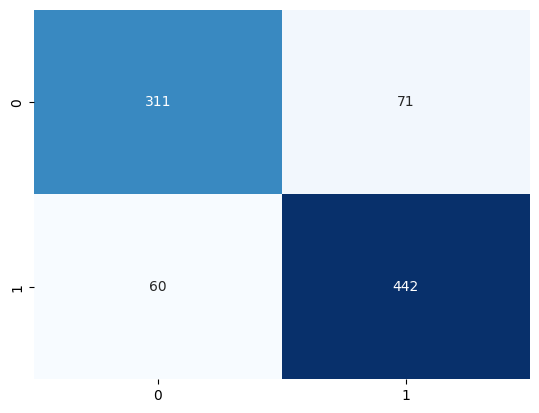

In [ ]:
con_matrix


sns.heatmap(con_matrix, annot=True, cmap='Blues', fmt='g', cbar=False)

Randomly selected subdirectory: nofire
Randomly selected image file: 0010.png


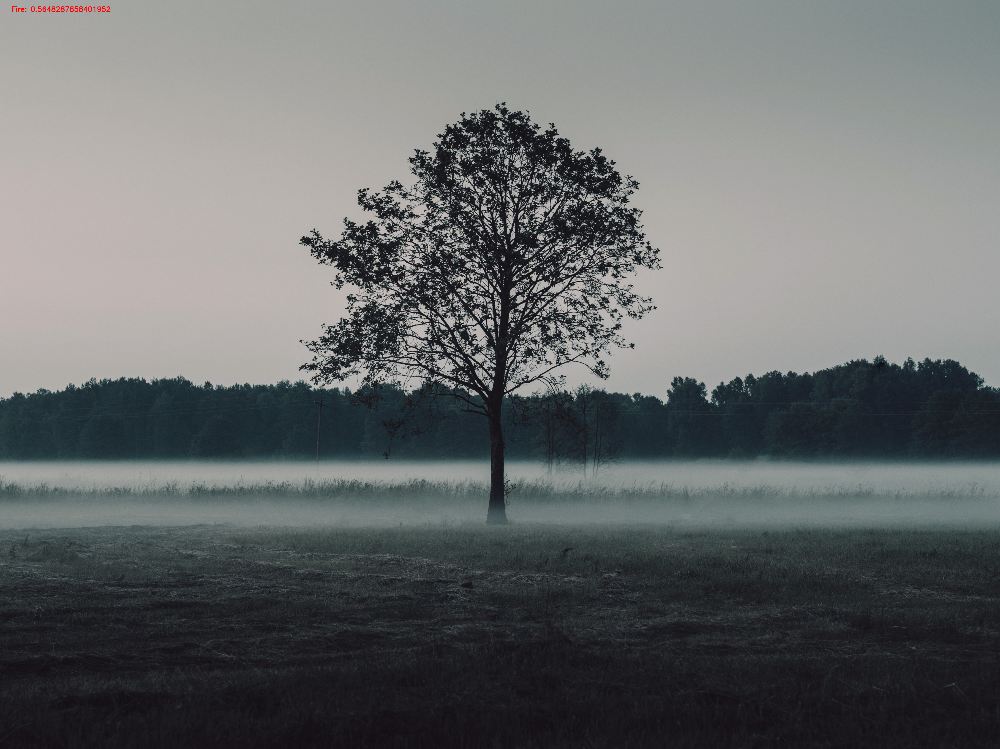

In [ ]:
import os
import random

# Set the path to the root directory containing your fire and non-fire subdirectories
root_directory = "/content/gdrive/MyDrive/ForestFireDataset/train"

# Get a list of subdirectories in the root directory
subdirectories = [d for d in os.listdir(root_directory) if os.path.isdir(os.path.join(root_directory, d))]

# Check if there are at least two subdirectories
if len(subdirectories) < 2:
    print("Error: The root directory should contain at least two subdirectories (one for fire and one for non-fire).")
else:
    # Randomly select a subdirectory (either 'fire' or 'non_fire')
    random_subdirectory = random.choice(subdirectories)
    print("Randomly selected subdirectory:", random_subdirectory)

    # Set the path to the randomly selected subdirectory
    image_directory = os.path.join(root_directory, random_subdirectory)

    # Get a list of all files in the subdirectory
    all_files = os.listdir(image_directory)

    # Filter the list to include only image files (you can customize the extensions)
    image_files = [file for file in all_files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp'))]

    # Check if there are any image files
    if not image_files:
        print(f"No image files found in the '{random_subdirectory}' subdirectory.")
    else:
        # Randomly select an image file
        random_image_file = random.choice(image_files)
        print("Randomly selected image file:", random_image_file)

        # Build the full path to the randomly selected image
        random_image_path = os.path.join(image_directory, random_image_file)

        # Read the image
        img = cv2.imread(random_image_path)

        # Resize and flatten the image for prediction
        resized_img = cv2.resize(img, (size, size))
        flattened_img = resized_img.flatten()

        # Perform the prediction
        result = forest_fire_model.predict_proba([flattened_img])

        # Display the image with the prediction result
        if result[0][1] > 0.1:
            img = cv2.putText(img, f"Fire: {result[0][1]}", (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2, cv2.LINE_AA)
        else:
            img = cv2.putText(img, f"No Fire: {result[0][0]}", (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2, cv2.LINE_AA)

        cv2_imshow(img)


In [ ]:
#print(classification_report(y_test,y_pred))